# Lesson 2: Image Segmentation

* If you would like to run this code on your own machine, you need to install the following:
    ```
    !pip install ultralytics torch
    ```

### Load the sample image

(4078, 2724)


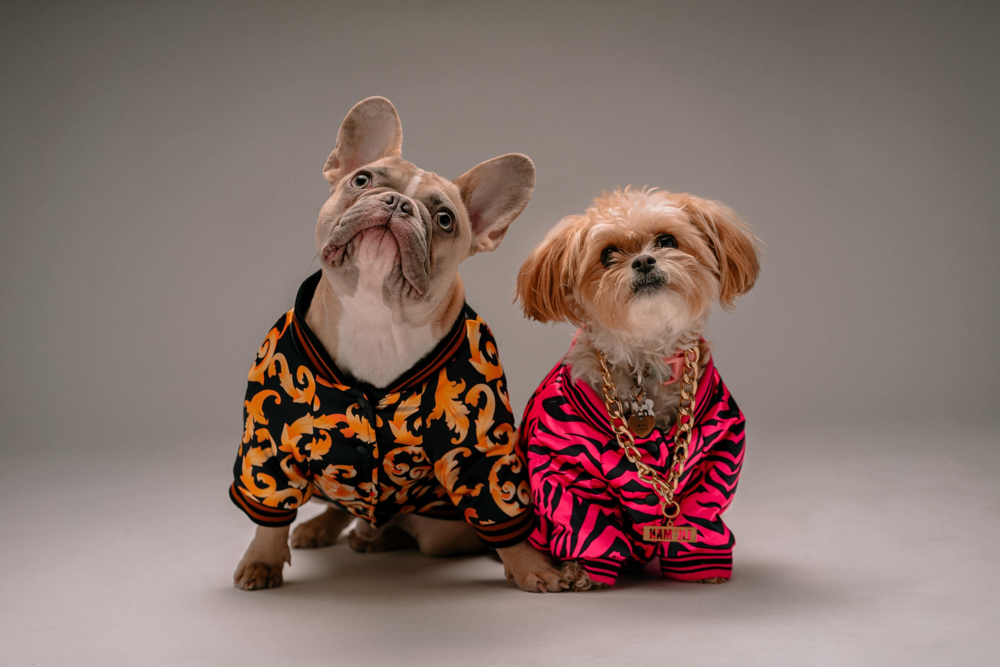

In [1]:
from PIL import Image
raw_image = Image.open("dogs.jpg")
print(raw_image.size)
raw_image

* Resize the image.

(1024, 684)


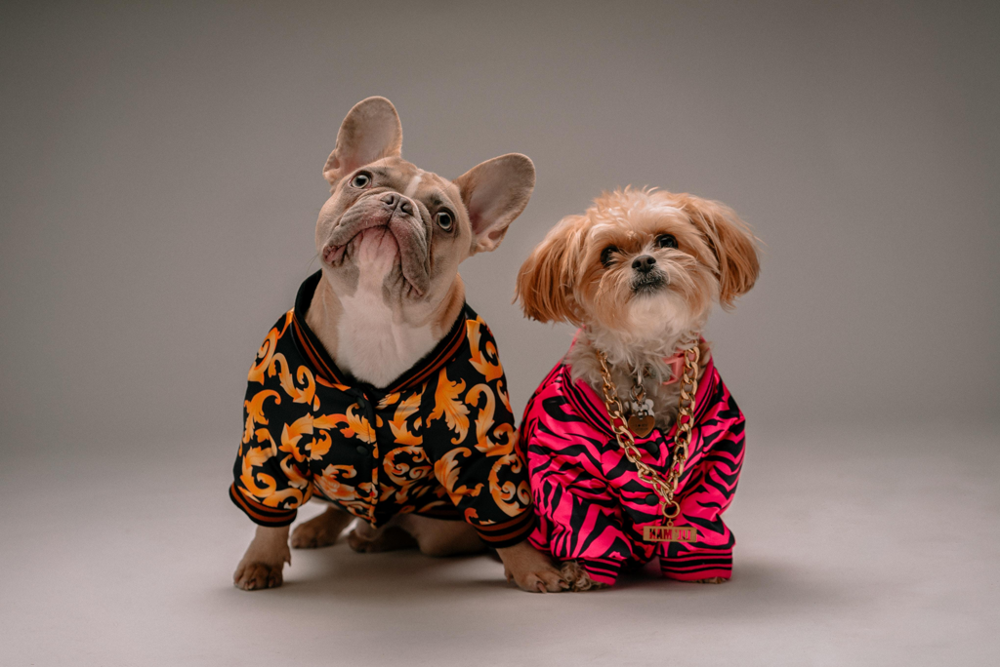

In [2]:
from utils import resize_image
resized_image = resize_image(raw_image, input_size=1024)
print(resized_image.size)
resized_image

### Import and prepare the model

In [3]:
import torch

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [5]:
from ultralytics import YOLO
model = YOLO('./models/comet-c1/FastSAM.pt')

Info about ['FastSAM'](https://docs.ultralytics.com/models/fast-sam/)

### Use the model

In [6]:
from utils import show_points_on_image

In [7]:
# Define the coordinates for the point in the image
# [x_axis, y_axis]
input_points = [ [350, 450 ] ]

In [8]:
input_labels = [1] # positive point

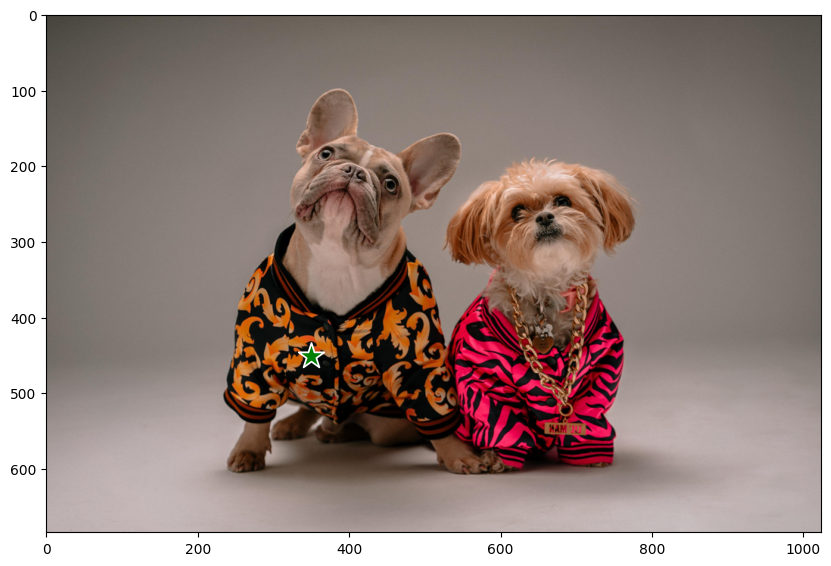

In [9]:
# Function written in the utils file
show_points_on_image(resized_image, input_points)

In [10]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 1366.6ms
Speed: 3.7ms preprocess, 1366.6ms inference, 687.8ms postprocess per image at shape (1, 3, 704, 1024)


In [11]:
results

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'object'}
 obb: None
 orig_img: array([[[ 60,  67,  70],
         [ 58,  65,  68],
         [ 58,  65,  68],
         ...,
         [ 72,  79,  82],
         [ 73,  80,  83],
         [ 70,  77,  80]],
 
        [[ 60,  67,  70],
         [ 62,  69,  72],
         [ 60,  67,  71],
         ...,
         [ 71,  78,  81],
         [ 73,  80,  83],
         [ 75,  82,  85]],
 
        [[ 61,  68,  71],
         [ 62,  69,  72],
         [ 62,  69,  72],
         ...,
         [ 74,  81,  84],
         [ 72,  79,  82],
         [ 72,  79,  82]],
 
        ...,
 
        [[176, 176, 188],
         [176, 176, 188],
         [175, 175, 187],
         ...,
         [172, 173, 183],
         [172, 173, 183],
         [175, 176, 186]],
 
        [[178, 178, 190],
         [177, 177, 189],
         [177, 177, 189

In [12]:
print(len(results), len(results[0].masks.data))
print(results[0].boxes.data[0].shape, \
      results[0].masks.data[0].shape)
results[0].boxes.data[0], results[0].masks.data[0]

1 23
torch.Size([6]) torch.Size([684, 1024])


(tensor([236.2495, 278.3009, 546.7557, 563.2970,   0.9626,   0.0000]),
 tensor([[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]))

* Filter the mask based on the point defined before.

In [13]:
from utils import format_results, point_prompt

In [14]:
results = format_results(results[0], 0)

In [15]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

In [16]:
from utils import show_masks_on_image

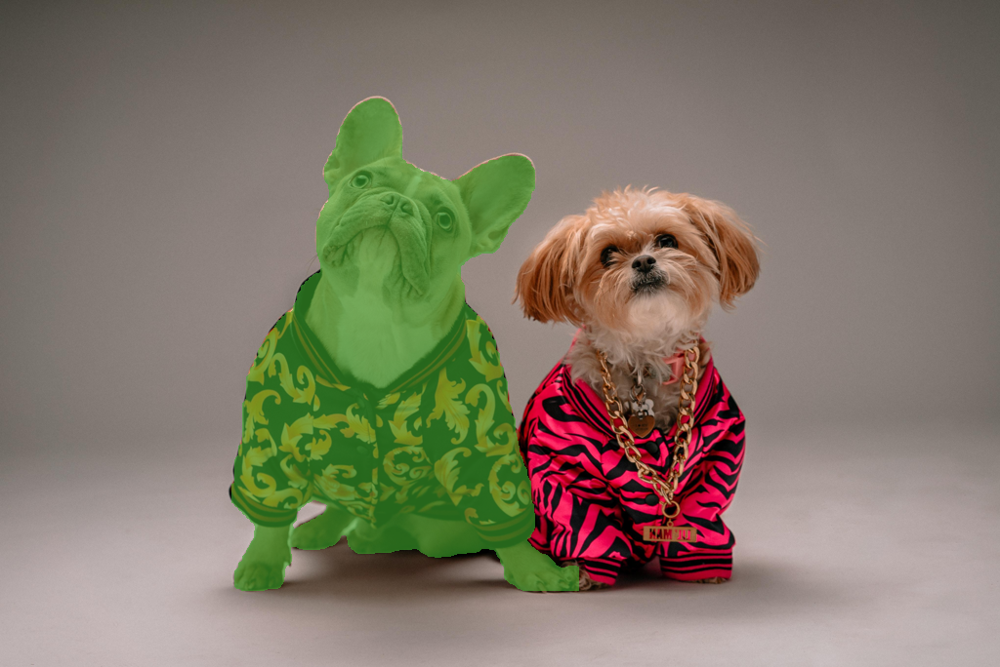

In [17]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

* Define 'semantic masks' - two points to be masked.

In [18]:
# Specify two points in the same image
# [x_axis, y_axis]
input_points = [ [350, 450], [620, 450] ]

In [19]:
# Specify both points as "positive prompt"
input_labels = [1 , 1] # both positive points

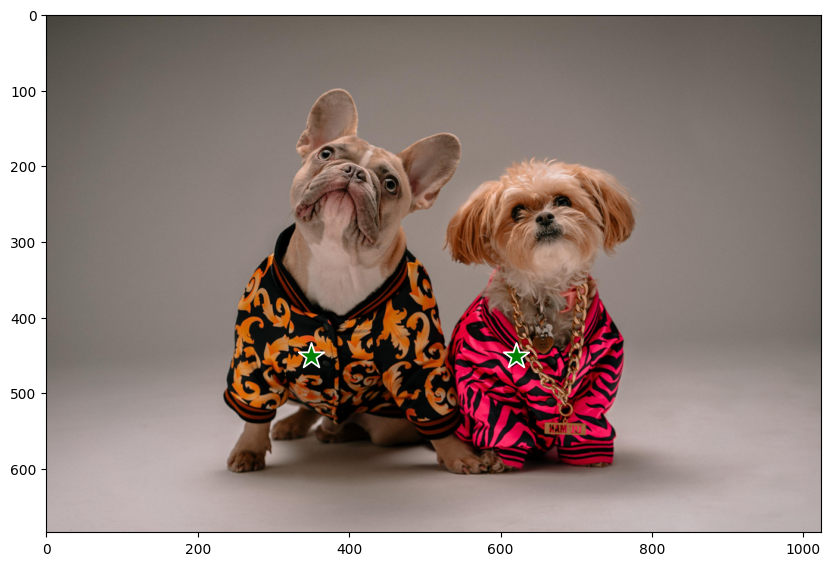

In [20]:
# Visualize the points defined before
show_points_on_image(resized_image, input_points)

In [21]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 1026.1ms
Speed: 2.3ms preprocess, 1026.1ms inference, 47.7ms postprocess per image at shape (1, 3, 704, 1024)


In [22]:
results = format_results(results[0], 0)

In [23]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

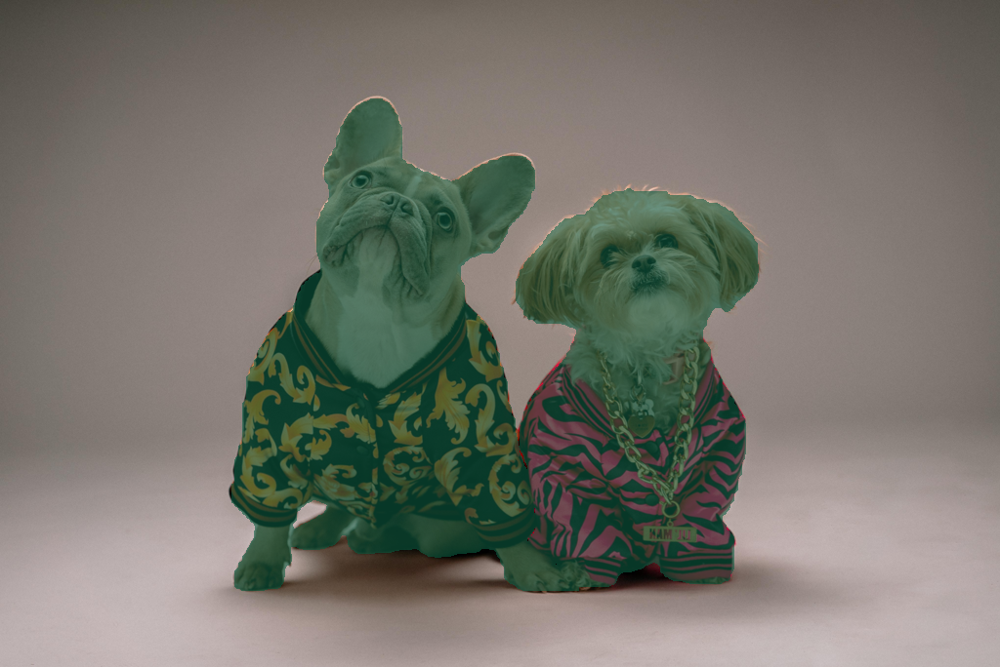

In [24]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

* Identify subsections of the image by adding a **negative prompt**.

In [25]:
# Define the coordinates for the regions to be masked
# [x_axis, y_axis]
input_points = [ [350, 450], [400, 300]  ]

In [26]:
input_labels = [1, 0] # positive prompt, negative prompt

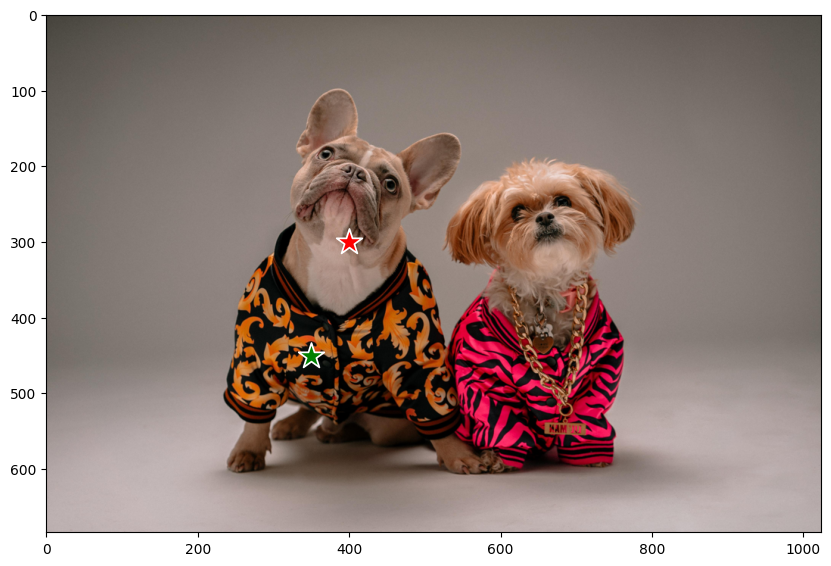

In [27]:
# Visualize the points defined above
show_points_on_image(resized_image, input_points, input_labels)

>Note: From the image above, the red star indicates the negative prompt and the green star the positive prompt.

In [28]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 1621.9ms
Speed: 2.6ms preprocess, 1621.9ms inference, 45.8ms postprocess per image at shape (1, 3, 704, 1024)


In [29]:
results = format_results(results[0], 0)

In [30]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

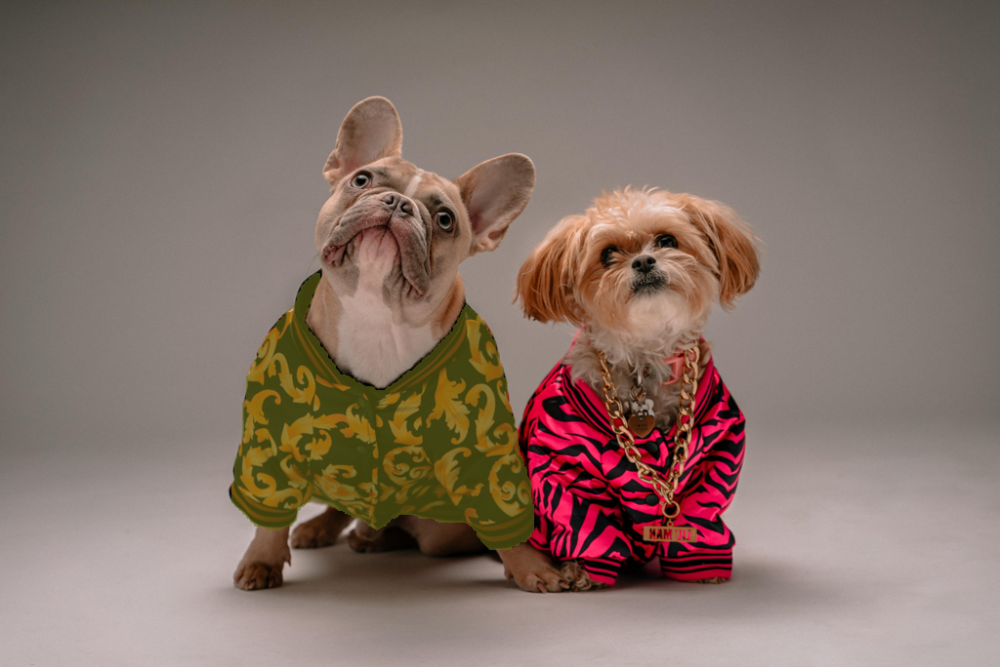

In [31]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

>Note: From the image above, only the jacket, from the dog in the left, was segmented, so, it is following the command given by the positive prompt!

### Prompting with bounding boxes

In [32]:
from utils import box_prompt

In [33]:
# Set the bounding box coordinates
# [xmin, ymin, xmax, ymax]
input_boxes = [530, 180, 780, 600]

In [34]:
from utils import show_boxes_on_image

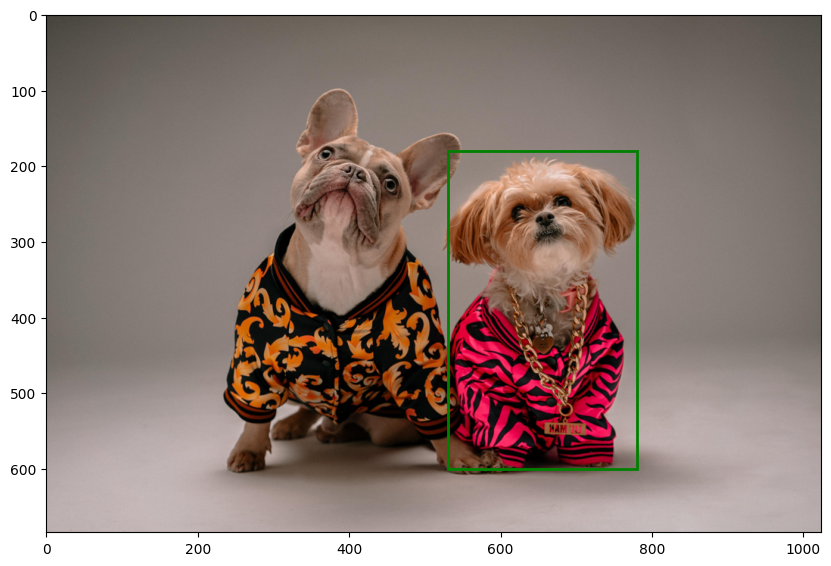

In [35]:
# Visualize the bounding box defined with the coordinates above
show_boxes_on_image(resized_image, [input_boxes])

* Now, try to isolate the mask from the total output of the model.

In [36]:
from utils import box_prompt

In [37]:
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 1176.7ms
Speed: 2.3ms preprocess, 1176.7ms inference, 45.5ms postprocess per image at shape (1, 3, 704, 1024)


In [38]:
# Generate the masks
masks = results[0].masks.data

In [39]:
masks

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0., 

In [40]:
# Convert to True/False boolean mask
masks = masks > 0

In [41]:
masks

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

In [42]:
masks, _ = box_prompt(masks, input_boxes)

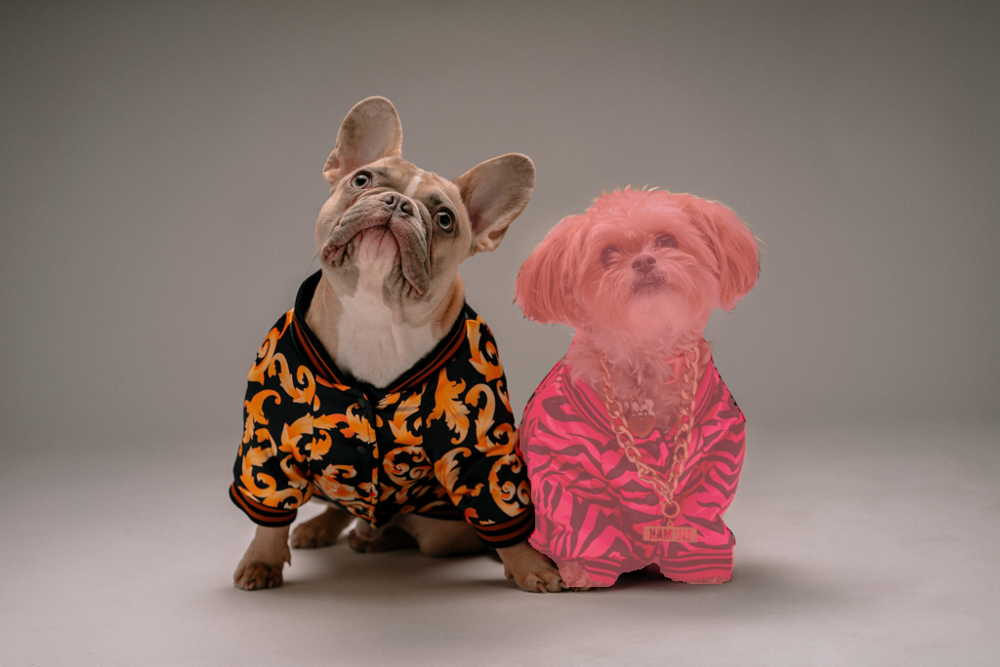

In [43]:
# Visualize the masks
show_masks_on_image(resized_image, [masks])

### Visualize the mask in raw format (instead of overlaying like above)

In [44]:
# Print the segmentation mask, but in its raw format
masks

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [45]:
# To visualize, import matplotlib
from matplotlib import pyplot as plt

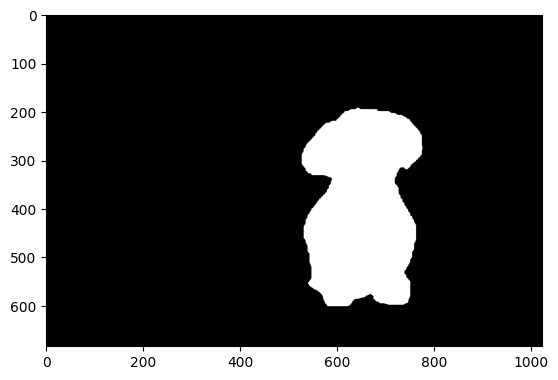

In [46]:
# Plot the binary mask as an image
plt.imshow(masks, cmap='gray')

### Additional Resources

* For more on how to use [Comet](https://www.comet.com/site/?utm_source=dlai&utm_medium=course&utm_campaign=prompt_engineering_for_vision_models&utm_content=dlai_L2) for experiment tracking, check out this [Quickstart Guide](https://colab.research.google.com/drive/1jj9BgsFApkqnpPMLCHSDH-5MoL_bjvYq?usp=sharing) and the [Comet Docs](https://www.comet.com/docs/v2/?utm_source=dlai&utm_medium=course&utm_campaign=prompt_engineering_for_vision_models&utm_content=dlai_L2).
* This course was based off a set of two blog articles from Comet. Explore them here for more on how to use newer versions of Stable Diffusion in this pipeline, additional tricks to improve your inpainting results, and a breakdown of the pipeline architecture:
  * [SAM + Stable Diffusion for Text-to-Image Inpainting](https://www.comet.com/site/blog/sam-stable-diffusion-for-text-to-image-inpainting/?utm_source=dlai&utm_medium=course&utm_campaign=prompt_engineering_for_vision_models&utm_content=dlai_L2)
  * [Image Inpainting for SDXL 1.0 Base Model + Refiner](https://www.comet.com/site/blog/image-inpainting-for-sdxl-1-0-base-refiner/?utm_source=dlai&utm_medium=course&utm_campaign=prompt_engineering_for_vision_models&utm_content=dlai_L2)
